In [2]:
import mysql.connector as mysql #pip install mysql.connector 
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
import requests
import json
import warnings
warnings.filterwarnings('ignore')

In [29]:
#Database Connection
db_connection = mysql.connect(user="root", password="jajasauce", host="34.143.214.112", database="steam")
cur = db_connection.cursor()


Indie                    5317
Action                   4009
Adventure                2981
Casual                   2237
Strategy                 1998
RPG                      1588
Simulation               1418
Early Access              891
Free to Play              450
Racing                    352
Sports                    336
Massively Multiplayer     282
Utilities                 105
Design & Illustration      66
Animation & Modeling       56
Software Training          56
Education                  44
Video Production           39
Audio Production           36
Photo Editing              19
Web Publishing             19
Accounting                  3
Name: genre, dtype: int64


<AxesSubplot:>

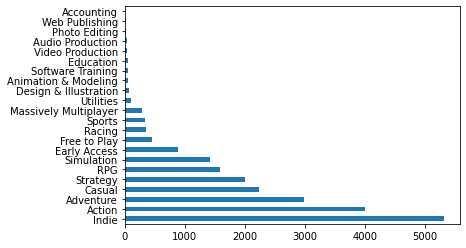

In [7]:
#What i want from the dataset , Get from 1st table : List of games App_ID_Info (List of all games on steam) 
# Merge 2 tables (App_ID_Info) and (GAMES_GENRES) to get the genre of games
#DONT RUN THIS FIRST THANKS
cur.execute("SELECT ap.appid,ap.title,ap.price,gg.genre FROM App_ID_Info ap INNER JOIN Games_Genres gg ON ap.appid = gg.appid WHERE ap.type = 'game';")

myresult = cur.fetchall()
df = pd.DataFrame(myresult,columns=['appid','title','price','genre'])
print(df['genre'].value_counts())

df['genre'].value_counts().plot(kind='barh')


Indie games are the most popular among game developers

In [4]:
#Does the developers of games affect the popularity / pricing of a game?
steam_data = pd.read_csv("steamdata/steamdata_clean.csv")
steam_data
 

,name,steam_appid,controller_support,dlc,short_description,demos,platforms,movies,achievements,release_date,genres,developer,publisher,owners,average_forever,median_forever,initialprice,languages,tags,rating
0,Counter-Strike,10,0,0,Play the world's number 1 online action game. ...,0,"windows, mac, linux",0,0,"1 Nov, 2000",Action,Valve,Valve,"10,000,000 .. 20,000,000",17612,317,9.99,"English, French, German, Italian, Spanish - Sp...","Action, FPS, Multiplayer, Shooter, Classic, Te...",97.3
1,Team Fortress Classic,20,0,0,One of the most popular online action games of...,0,"windows, mac, linux",0,0,"1 Apr, 1999",Action,Valve,Valve,"5,000,000 .. 10,000,000",277,62,4.99,"English, French, German, Italian, Spanish - Sp...","Action, FPS, Multiplayer, Classic, Shooter, Cl...",82.8
2,Day of Defeat,30,0,0,Enlist in an intense brand of Axis vs. Allied ...,0,"windows, mac, linux",0,0,"1 May, 2003",Action,Valve,Valve,"5,000,000 .. 10,000,000",187,34,4.99,"English, French, German, Italian, Spanish - Spain","FPS, World War II, Multiplayer, Action, Shoote...",88.6
3,Deathmatch Classic,40,0,0,Enjoy fast-paced multiplayer gaming with Death...,0,"windows, mac, linux",0,0,"1 Jun, 2001",Action,Valve,Valve,"5,000,000 .. 10,000,000",258,184,4.99,"English, French, German, Italian, Spanish - Sp...","Action, FPS, Multiplayer, Classic, Shooter, Fi...",80.7
4,Half-Life: Opposing Force,50,0,0,Return to the Black Mesa Research Facility as ...,0,"windows, mac, linux",0,0,"1 Nov, 1999",Action,Gearbox Software,Valve,"5,000,000 .. 10,000,000",624,415,4.99,"English, French, German, Korean","FPS, Action, Sci-fi, Singleplayer, Classic, Sh...",94.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27188,Room of Pandora,1065230,0,0,The Room of Pandora is a third-person interact...,0,windows,1,7,"24 Apr, 2019","Adventure, Casual, Indie",SHEN JIAWEI,SHEN JIAWEI,"0 .. 20,000",0,0,2.99,"English, Japanese, Simplified Chinese, Traditi...","Adventure, Indie, Casual, Puzzle",43.8
27189,Cyber Gun,1065570,0,0,Cyber Gun is a hardcore first-person shooter w...,0,windows,1,0,"23 Apr, 2019","Action, Adventure, Indie",Semyon Maximov,BekkerDev Studio,"0 .. 20,000",0,0,1.99,English,"Action, Indie, Adventure, FPS, 3D Platformer, ...",56.5
27190,Super Star Blast,1065650,1,0,Super Star Blast is a space based game with ch...,0,windows,1,24,"24 Apr, 2019","Action, Casual, Indie",EntwicklerX,EntwicklerX,"0 .. 20,000",0,0,4.99,English,"Action, Indie, Casual",0.0
27191,New Yankee 7: Deer Hunters,1066700,0,0,Pursue a snow-white deer through an enchanted ...,0,"windows, mac",1,0,"17 Apr, 2019","Adventure, Casual, Indie",Yustas Game Studio,Alawar Entertainment,"0 .. 20,000",0,0,6.99,"English, German, Korean, Russian","Indie, Casual, Adventure",34.2


In [5]:
#Since my computer cant handle 420GB of data, we shall use a csv of users and call steam api for more user info (https://developer.valvesoftware.com/wiki/Steam_Web_API)


API = "ECCEBC3740A7FA6CFA36558732B4FCB1"
steam_data = pd.read_csv("SteamUserData/playerInfo.csv",nrows=20000)

#friends data
response = requests.get("https://api.steampowered.com/ISteamUser/GetFriendList/v0001/?key="+API+"&steamid="+str(steam_data['steamid'][0])+"&relationship=friend")
reply = response.json();

#print(reply['friendslist']['friends'][0]['steamid'])


#for x in reply['friendslist']['friends']:
#    print(x['steamid'])

#User game library data
counter = 0;
data1 = {'steamid':[],'gamesid':[],'playtime_forever':[]}
dfGames = pd.DataFrame(data1)

for x in steam_data['steamid']:
    response = requests.get("http://api.steampowered.com/IPlayerService/GetOwnedGames/v0001/?key="+API+"&steamid="+str(x)+"&format=json")
    reply = response.json(); 
    if(reply['response'] == {}):
        continue
    else:
        for y in reply['response']['games']: # save it to data frame instead
            new_row = {'steamid':str(x),'gamesid':y['appid'],'playtime_forever':y['playtime_forever']}
            dfGames = dfGames.append(new_row, ignore_index=True)
            print(new_row)
    
    

{'steamid': '76561197960265851', 'gamesid': 10, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 20, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 30, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 40, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 50, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 60, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 70, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 130, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 80, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 100, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 220, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 240, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 280, 'playtime_forever': 0}
{'steamid': '76561197960265851', 'gamesid': 300, 'playtime_forever': 0}


In [ ]:
#Does friends playing the game affect whether someone will buy a game?
# Does a player's prefered game genre affect what genre games they play?



In [1]:
#cur.execute("SELECT steamid,personaname FROM Player_Summaries WHERE personastate != 0 LIMIT 100000;")

#myresult = cur.fetchall()
#df = pd.DataFrame(myresult,columns=['steamid','personaname'])
#dfGames.to_csv('playerGames.csv', index=False)


NameError: name 'dfGames' is not defined